# **Symptom-Based Disease Classification Using ML Algorithms**
[Dataset Link](https://www.kaggle.com/datasets/kaushil268/disease-prediction-using-machine-learning)
\
\
**Dataset Overview:** The dataset consists of two CSV files - one for training and the other for testing. Each file contains 133 columns, with 132 columns representing different symptoms experienced by individuals encoded with binary values (0 for absence of symptoms and 1 for presence of symptoms) and the last column indicating the prognosis (disease classification). The training dataset includes a set of symptoms for 41 different diseases of 4920 patient records. The testing dataset is used to evaluate the performance of the trained models by prediction of diseases based on a given set of symptoms.

# Dataset Characteristics and Exploratory Data Analysis

## Load, View Data and Analysis on Rows and Columns

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import missingno as msno
import matplotlib.pyplot as plt
from sklearn.utils import shuffle

import warnings
warnings.filterwarnings('ignore')

In [3]:
# Loading the dataset
train = pd.read_csv('/content/drive/MyDrive/Training.csv')
test = pd.read_csv('/content/drive/MyDrive/Testing.csv')

In [4]:
# Displaying the full content
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_colwidth', None)

In [5]:
train = shuffle(train, random_state=42)

In [6]:
train.head().T

,373,4916,1550,3081,3857
itching,0,0,0,0,1
skin_rash,1,1,0,0,0
nodal_skin_eruptions,0,0,0,0,0
continuous_sneezing,0,0,0,0,0
shivering,0,0,0,0,0
chills,0,0,0,0,0
joint_pain,0,0,0,0,0
stomach_pain,0,0,0,0,0
acidity,0,0,0,0,0
ulcers_on_tongue,0,0,0,0,0


In [7]:
train['Unnamed: 133'].value_counts()

Series([], Name: Unnamed: 133, dtype: int64)

The 'Unnamed: 133' column contains NaN values. So, we drop the column.

In [8]:
# Dropping unnecessary columns
train = train.drop(columns=['Unnamed: 133'])

In [9]:
rows, cols = train.shape

print(f'Number of rows: {rows}')
print(f'Number of columns: {cols}')
print(f'Total cells: {rows * cols}')

Number of rows: 4920
Number of columns: 133
Total cells: 654360


In [10]:
train.columns.tolist()

['itching',
 'skin_rash',
 'nodal_skin_eruptions',
 'continuous_sneezing',
 'shivering',
 'chills',
 'joint_pain',
 'stomach_pain',
 'acidity',
 'ulcers_on_tongue',
 'muscle_wasting',
 'vomiting',
 'burning_micturition',
 'spotting_ urination',
 'fatigue',
 'weight_gain',
 'anxiety',
 'cold_hands_and_feets',
 'mood_swings',
 'weight_loss',
 'restlessness',
 'lethargy',
 'patches_in_throat',
 'irregular_sugar_level',
 'cough',
 'high_fever',
 'sunken_eyes',
 'breathlessness',
 'sweating',
 'dehydration',
 'indigestion',
 'headache',
 'yellowish_skin',
 'dark_urine',
 'nausea',
 'loss_of_appetite',
 'pain_behind_the_eyes',
 'back_pain',
 'constipation',
 'abdominal_pain',
 'diarrhoea',
 'mild_fever',
 'yellow_urine',
 'yellowing_of_eyes',
 'acute_liver_failure',
 'fluid_overload',
 'swelling_of_stomach',
 'swelled_lymph_nodes',
 'malaise',
 'blurred_and_distorted_vision',
 'phlegm',
 'throat_irritation',
 'redness_of_eyes',
 'sinus_pressure',
 'runny_nose',
 'congestion',
 'chest_pain',


In [11]:
train.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4920 entries, 373 to 860
Columns: 133 entries, itching to prognosis
dtypes: int64(132), object(1)
memory usage: 5.0+ MB


In [12]:
print('Overview of Columns:')
train.describe().transpose()

Overview of Columns:


,count,mean,std,min,25%,50%,75%,max
itching,4920.0,0.137805,0.344730,0.0,0.0,0.0,0.0,1.0
skin_rash,4920.0,0.159756,0.366417,0.0,0.0,0.0,0.0,1.0
nodal_skin_eruptions,4920.0,0.021951,0.146539,0.0,0.0,0.0,0.0,1.0
continuous_sneezing,4920.0,0.045122,0.207593,0.0,0.0,0.0,0.0,1.0
shivering,4920.0,0.021951,0.146539,0.0,0.0,0.0,0.0,1.0
chills,4920.0,0.162195,0.368667,0.0,0.0,0.0,0.0,1.0
joint_pain,4920.0,0.139024,0.346007,0.0,0.0,0.0,0.0,1.0
stomach_pain,4920.0,0.045122,0.207593,0.0,0.0,0.0,0.0,1.0
acidity,4920.0,0.045122,0.207593,0.0,0.0,0.0,0.0,1.0
ulcers_on_tongue,4920.0,0.021951,0.146539,0.0,0.0,0.0,0.0,1.0


All of the symptoms columns are filled with binary values. The 'fluid_overload' column contains only 0s, making it a constant column that does not provide any information for model training.

In [13]:
train.head().T

,373,4916,1550,3081,3857
itching,0,0,0,0,1
skin_rash,1,1,0,0,0
nodal_skin_eruptions,0,0,0,0,0
continuous_sneezing,0,0,0,0,0
shivering,0,0,0,0,0
chills,0,0,0,0,0
joint_pain,0,0,0,0,0
stomach_pain,0,0,0,0,0
acidity,0,0,0,0,0
ulcers_on_tongue,0,0,0,0,0


## Data Cleaning

In [14]:
# Identifying missing values
train.isna().sum().sum()

0

There are no missing values in the dataset.

Duplicated rows will not be dropped from the training dataset, as they provide useful information indicating a pattern among the diseases.

In [15]:
sorted(train.columns.tolist())

['abdominal_pain',
 'abnormal_menstruation',
 'acidity',
 'acute_liver_failure',
 'altered_sensorium',
 'anxiety',
 'back_pain',
 'belly_pain',
 'blackheads',
 'bladder_discomfort',
 'blister',
 'blood_in_sputum',
 'bloody_stool',
 'blurred_and_distorted_vision',
 'breathlessness',
 'brittle_nails',
 'bruising',
 'burning_micturition',
 'chest_pain',
 'chills',
 'cold_hands_and_feets',
 'coma',
 'congestion',
 'constipation',
 'continuous_feel_of_urine',
 'continuous_sneezing',
 'cough',
 'cramps',
 'dark_urine',
 'dehydration',
 'depression',
 'diarrhoea',
 'dischromic _patches',
 'distention_of_abdomen',
 'dizziness',
 'drying_and_tingling_lips',
 'enlarged_thyroid',
 'excessive_hunger',
 'extra_marital_contacts',
 'family_history',
 'fast_heart_rate',
 'fatigue',
 'fluid_overload',
 'fluid_overload.1',
 'foul_smell_of urine',
 'headache',
 'high_fever',
 'hip_joint_pain',
 'history_of_alcohol_consumption',
 'increased_appetite',
 'indigestion',
 'inflammatory_nails',
 'internal_itch

There are two different 'fluid_overload' and 'fluid_overload.1' columns in the dataset.

In [16]:
train[train['fluid_overload'] == 1].head().T

""
itching
skin_rash
nodal_skin_eruptions
continuous_sneezing
shivering
chills
joint_pain
stomach_pain
acidity
ulcers_on_tongue


In [17]:
train[train['fluid_overload.1'] == 1].head().T

,1471,4411,4288,655,653
itching,0,0,0,0,0
skin_rash,0,0,0,0,0
nodal_skin_eruptions,0,0,0,0,0
continuous_sneezing,0,0,0,0,0
shivering,0,0,0,0,0
chills,0,0,0,0,0
joint_pain,0,0,0,0,0
stomach_pain,0,0,0,0,0
acidity,0,0,0,0,0
ulcers_on_tongue,0,0,0,0,0


The presence of the 'fluid_overload.1' symptom is indicative of the 'Alcoholic hepatitis' disease as shown above, while the 'fluid_overload' symptom does not serve as a specific indicator for any particular disease. So, we drop the column from both training and testing dataset.

In [18]:
# Dropping 'fluid_overload' from the train and test dataset
train.drop('fluid_overload', axis=1, inplace=True)
test.drop('fluid_overload', axis=1, inplace=True)

## Analysing Patterns using Visualisations

### Visualization of column correlation and plotting Heat Map

In [19]:
# Encoding the target value into numerical value using LabelEncoder for correlation plot
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()
train['disease'] = label_encoder.fit_transform(train['prognosis'])

In [20]:
corr = train.corr(numeric_only=True).round(2)
corr.style.background_gradient(cmap=sns.diverging_palette(20, 220, as_cmap=True), axis=None).format(precision=2)

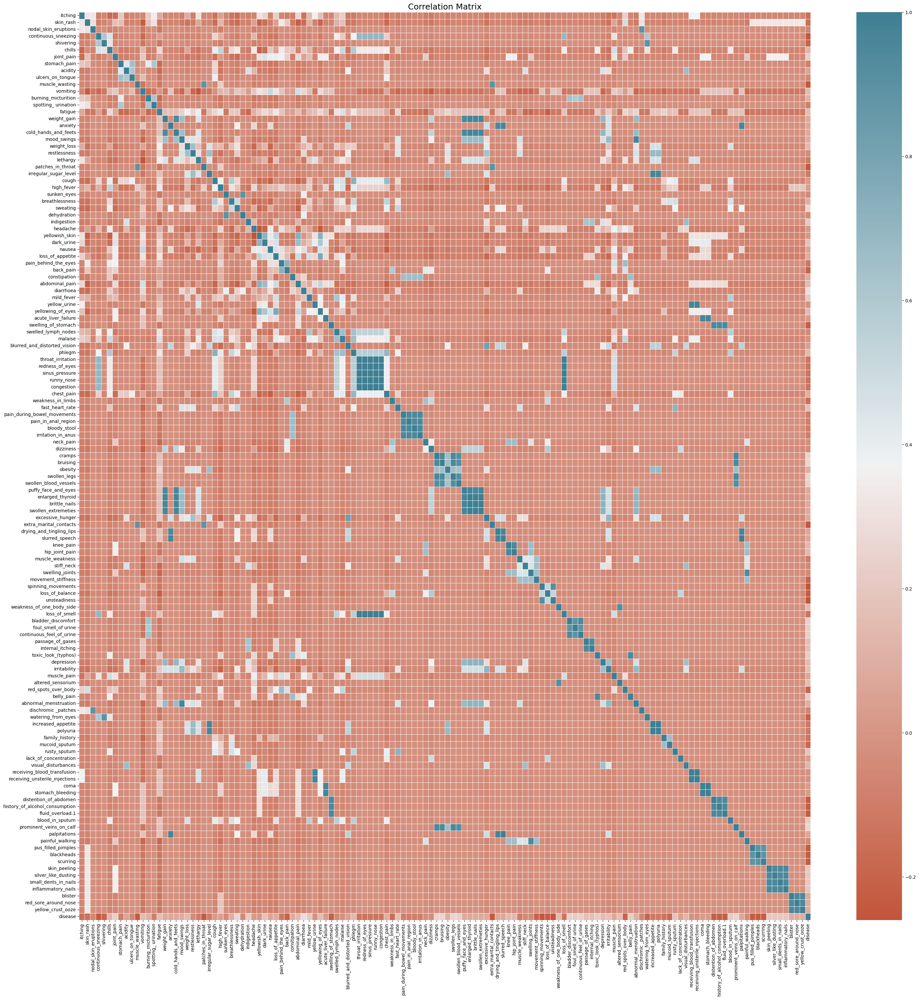

In [21]:
fig, ax = plt.subplots(figsize=(36, 36))
sns.heatmap(corr, cmap=sns.diverging_palette(20, 220, n=256), annot=False, linewidth=0.5)
plt.title('Correlation Matrix', fontsize = 18)
plt.show()

In [22]:
threshold = 0.98

# Highly correlated feature pairs
high_corr_pairs = set()
for col in corr.columns:
    correlated_cols = corr.index[corr[col] > threshold].tolist()
    for correlated_col in correlated_cols:
        if col != correlated_col:
            pair = tuple(sorted([col, correlated_col]))
            high_corr_pairs.add(pair)

high_corr_pairs

{('brittle_nails', 'enlarged_thyroid'),
 ('brittle_nails', 'swollen_extremeties'),
 ('coma', 'stomach_bleeding'),
 ('congestion', 'loss_of_smell'),
 ('congestion', 'redness_of_eyes'),
 ('congestion', 'runny_nose'),
 ('congestion', 'sinus_pressure'),
 ('congestion', 'throat_irritation'),
 ('enlarged_thyroid', 'swollen_extremeties'),
 ('increased_appetite', 'polyuria'),
 ('loss_of_smell', 'redness_of_eyes'),
 ('loss_of_smell', 'runny_nose'),
 ('loss_of_smell', 'sinus_pressure'),
 ('loss_of_smell', 'throat_irritation'),
 ('palpitations', 'slurred_speech'),
 ('receiving_blood_transfusion', 'receiving_unsterile_injections'),
 ('redness_of_eyes', 'runny_nose'),
 ('redness_of_eyes', 'sinus_pressure'),
 ('redness_of_eyes', 'throat_irritation'),
 ('runny_nose', 'sinus_pressure'),
 ('runny_nose', 'throat_irritation'),
 ('sinus_pressure', 'throat_irritation')}

In [23]:
correlation_with_disease = corr['disease'].sort_values(ascending=False)

# Features with high positive correlation
high_positive_correlation = correlation_with_disease[(correlation_with_disease > 0.2) & (correlation_with_disease != 1)]
print('Features with high positive correlation:')
print(high_positive_correlation)

Features with high positive correlation:
diarrhoea                   0.29
sweating                    0.26
cramps                      0.25
bruising                    0.25
swollen_legs                0.25
prominent_veins_on_calf     0.25
swollen_blood_vessels       0.24
joint_pain                  0.23
bladder_discomfort          0.23
continuous_feel_of_urine    0.23
belly_pain                  0.22
foul_smell_of urine         0.22
toxic_look_(typhos)         0.22
blood_in_sputum             0.21
indigestion                 0.21
Name: disease, dtype: float64


Almost all symptoms have weak linear correlations. However, some symptoms have high correlations between them indicating they tend to occur together in the dataset or are associated with particular diseases.

For example, if symptoms A and B have a high correlation for a specific disease, it means that when a patient has symptom A, there is a higher likelihood of also having symptom B and vice versa. Similarly, high correlation between a symptom and a disease implies that the presence of that symptom is indicative of the particular disease.

### Visualization of column relationships

In [24]:
train = train.drop('disease', axis=1)

In [25]:
# Number of unique diseases
train['prognosis'].nunique()

41

In [26]:
# Unique diseases
sorted(train['prognosis'].unique())

['(vertigo) Paroymsal  Positional Vertigo',
 'AIDS',
 'Acne',
 'Alcoholic hepatitis',
 'Allergy',
 'Arthritis',
 'Bronchial Asthma',
 'Cervical spondylosis',
 'Chicken pox',
 'Chronic cholestasis',
 'Common Cold',
 'Dengue',
 'Diabetes ',
 'Dimorphic hemmorhoids(piles)',
 'Drug Reaction',
 'Fungal infection',
 'GERD',
 'Gastroenteritis',
 'Heart attack',
 'Hepatitis B',
 'Hepatitis C',
 'Hepatitis D',
 'Hepatitis E',
 'Hypertension ',
 'Hyperthyroidism',
 'Hypoglycemia',
 'Hypothyroidism',
 'Impetigo',
 'Jaundice',
 'Malaria',
 'Migraine',
 'Osteoarthristis',
 'Paralysis (brain hemorrhage)',
 'Peptic ulcer diseae',
 'Pneumonia',
 'Psoriasis',
 'Tuberculosis',
 'Typhoid',
 'Urinary tract infection',
 'Varicose veins',
 'hepatitis A']

In [27]:
# Total symptom occurrence
symptom_occurrence = train.iloc[:, :-1].sum(axis=0)

for symptom, count in symptom_occurrence.items():
    print(f"{symptom}: {count}")

itching: 678
skin_rash: 786
nodal_skin_eruptions: 108
continuous_sneezing: 222
shivering: 108
chills: 798
joint_pain: 684
stomach_pain: 222
acidity: 222
ulcers_on_tongue: 108
muscle_wasting: 108
vomiting: 1914
burning_micturition: 216
spotting_ urination: 108
fatigue: 1932
weight_gain: 114
anxiety: 114
cold_hands_and_feets: 114
mood_swings: 228
weight_loss: 456
restlessness: 228
lethargy: 456
patches_in_throat: 108
irregular_sugar_level: 114
cough: 564
high_fever: 1362
sunken_eyes: 108
breathlessness: 450
sweating: 678
dehydration: 108
indigestion: 222
headache: 1134
yellowish_skin: 912
dark_urine: 570
nausea: 1146
loss_of_appetite: 1152
pain_behind_the_eyes: 120
back_pain: 228
constipation: 228
abdominal_pain: 1032
diarrhoea: 564
mild_fever: 354
yellow_urine: 114
yellowing_of_eyes: 816
acute_liver_failure: 114
swelling_of_stomach: 114
swelled_lymph_nodes: 348
malaise: 702
blurred_and_distorted_vision: 342
phlegm: 354
throat_irritation: 120
redness_of_eyes: 120
sinus_pressure: 120
runn

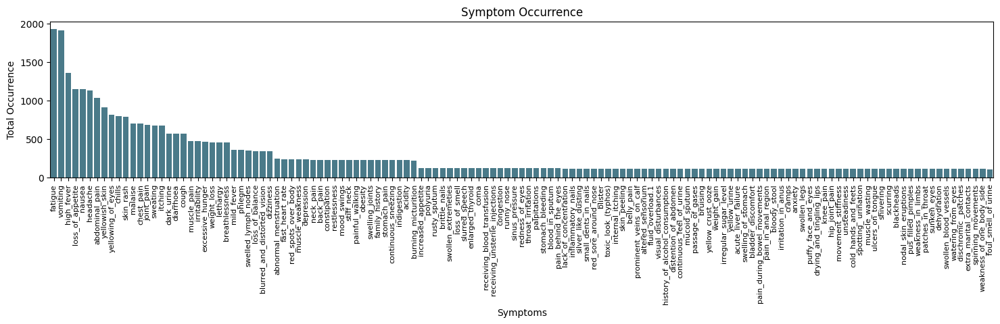

In [28]:
sorted_symptoms = symptom_occurrence.sort_values(ascending=False)

plt.figure(figsize=(18, 3))
sns.barplot(x=sorted_symptoms.index, y=sorted_symptoms.values, color='#3F7F93')
plt.title('Symptom Occurrence')
plt.xlabel('Symptoms')
plt.ylabel('Total Occurrence')
plt.xticks(rotation=90, fontsize=8)
plt.show()

In [29]:
# Types of disease
disease_counts = train['prognosis'].value_counts()
disease_counts

Acne                                       120
Pneumonia                                  120
Gastroenteritis                            120
Varicose veins                             120
Jaundice                                   120
Drug Reaction                              120
(vertigo) Paroymsal  Positional Vertigo    120
Heart attack                               120
Tuberculosis                               120
Typhoid                                    120
Common Cold                                120
Peptic ulcer diseae                        120
Paralysis (brain hemorrhage)               120
Fungal infection                           120
Impetigo                                   120
GERD                                       120
Dengue                                     120
Malaria                                    120
Chicken pox                                120
Hypothyroidism                             120
Hepatitis C                                120
Hyperthyroidi

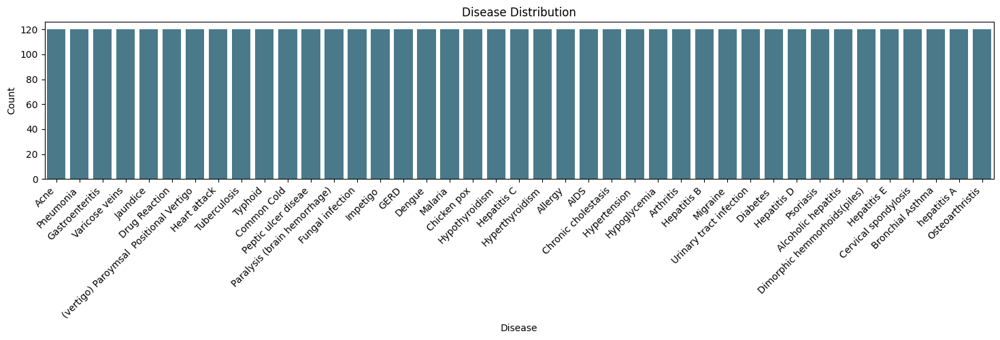

In [30]:
plt.figure(figsize=(18, 3))
ax = sns.countplot(x='prognosis', data=train, color='#3F7F93', order=disease_counts.index)
plt.title('Disease Distribution')
plt.xlabel('Disease')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')
plt.show()

In [31]:
# All corresponding symptoms for diseases
# Grouping the dataset by disease
grouped_by_disease = train.groupby('prognosis')

result_df = pd.DataFrame(columns=['Disease', 'Symptoms', 'Symptom Count'])

for disease, group_data in grouped_by_disease:
    symptoms_with_1 = group_data.columns[:-1][group_data.iloc[0, :-1] == 1].tolist()
    symptom_count = len(symptoms_with_1)
    result_df = result_df.append({'Disease': disease, 'Symptoms': ', '.join(symptoms_with_1), 'Symptom Count': symptom_count}, ignore_index=True)

result_df = result_df.sort_values(by='Symptom Count', ascending=False)
result_df

,Disease,Symptoms,Symptom Count
10,Common Cold,"continuous_sneezing, chills, fatigue, cough, high_fever, headache, swelled_lymph_nodes, malaise, phlegm, throat_irritation, redness_of_eyes, sinus_pressure, runny_nose, congestion, chest_pain, loss_of_smell, muscle_pain",17
36,Tuberculosis,"chills, vomiting, weight_loss, cough, high_fever, breathlessness, sweating, loss_of_appetite, mild_fever, yellowing_of_eyes, swelled_lymph_nodes, malaise, phlegm, chest_pain, blood_in_sputum",15
11,Dengue,"skin_rash, chills, vomiting, fatigue, high_fever, headache, nausea, loss_of_appetite, pain_behind_the_eyes, back_pain, malaise, muscle_pain, red_spots_over_body",13
22,Hepatitis E,"joint_pain, vomiting, fatigue, high_fever, yellowish_skin, dark_urine, nausea, loss_of_appetite, abdominal_pain, yellowing_of_eyes, acute_liver_failure, coma, stomach_bleeding",13
25,Hypoglycemia,"vomiting, fatigue, anxiety, sweating, headache, nausea, blurred_and_distorted_vision, excessive_hunger, drying_and_tingling_lips, slurred_speech, irritability, palpitations",12
26,Hypothyroidism,"fatigue, weight_gain, mood_swings, lethargy, dizziness, puffy_face_and_eyes, enlarged_thyroid, brittle_nails, swollen_extremeties, depression, irritability, abnormal_menstruation",12
19,Hepatitis B,"itching, fatigue, lethargy, yellowish_skin, dark_urine, loss_of_appetite, abdominal_pain, yellow_urine, yellowing_of_eyes, malaise, receiving_blood_transfusion, receiving_unsterile_injections",12
8,Chicken pox,"itching, skin_rash, fatigue, lethargy, high_fever, headache, loss_of_appetite, mild_fever, swelled_lymph_nodes, malaise, red_spots_over_body",11
34,Pneumonia,"chills, fatigue, cough, high_fever, breathlessness, sweating, malaise, phlegm, chest_pain, fast_heart_rate, rusty_sputum",11
37,Typhoid,"chills, vomiting, fatigue, high_fever, headache, nausea, constipation, abdominal_pain, diarrhoea, toxic_look_(typhos), belly_pain",11


In [32]:
symptom_df = pd.DataFrame(columns=['Symptom', 'Diseases', 'Disease Count'])

for symptom in train.columns[:-1]:
    diseases_with_symptom = train.loc[train[symptom] == 1, 'prognosis'].unique()
    disease_count = len(diseases_with_symptom)
    symptom_df = symptom_df.append({'Symptom': symptom, 'Diseases': ', '.join(diseases_with_symptom), 'Disease Count': disease_count}, ignore_index=True)

symptom_df = symptom_df.sort_values(by='Disease Count', ascending=False)
symptom_df

,Symptom,Diseases,Disease Count
14,fatigue,"Hyperthyroidism, Hypoglycemia, Hepatitis B, Diabetes , Hepatitis D, Hepatitis E, Bronchial Asthma, Hepatitis C, Pneumonia, Hypothyroidism, Varicose veins, Jaundice, Typhoid, Common Cold, Tuberculosis, Dengue, Chicken pox",17
11,vomiting,"Chronic cholestasis, Hypoglycemia, Hepatitis D, Alcoholic hepatitis, Hepatitis E, hepatitis A, Gastroenteritis, Jaundice, (vertigo) Paroymsal Positional Vertigo, Heart attack, Tuberculosis, Typhoid, Peptic ulcer diseae, Paralysis (brain hemorrhage), GERD, Dengue, Malaria",17
25,high_fever,"AIDS, Hepatitis E, Bronchial Asthma, Pneumonia, Jaundice, Tuberculosis, Typhoid, Common Cold, Impetigo, Dengue, Malaria, Chicken pox",12
35,loss_of_appetite,"Chronic cholestasis, Hepatitis B, Hepatitis D, Hepatitis E, hepatitis A, Hepatitis C, Tuberculosis, Peptic ulcer diseae, Dengue, Chicken pox",10
34,nausea,"Chronic cholestasis, Hypoglycemia, Hepatitis D, Hepatitis E, hepatitis A, Hepatitis C, (vertigo) Paroymsal Positional Vertigo, Typhoid, Dengue, Malaria",10
31,headache,"Hypertension , Hypoglycemia, Migraine, (vertigo) Paroymsal Positional Vertigo, Typhoid, Common Cold, Paralysis (brain hemorrhage), Dengue, Malaria, Chicken pox",10
39,abdominal_pain,"Chronic cholestasis, Hepatitis B, Hepatitis D, Alcoholic hepatitis, Hepatitis E, Jaundice, Typhoid, Peptic ulcer diseae, hepatitis A",9
32,yellowish_skin,"Chronic cholestasis, Hepatitis B, Hepatitis D, Alcoholic hepatitis, Hepatitis E, hepatitis A, Hepatitis C, Jaundice",8
43,yellowing_of_eyes,"Chronic cholestasis, Hepatitis B, Hepatitis D, Hepatitis E, hepatitis A, Hepatitis C, Tuberculosis",7
1,skin_rash,"Acne, Psoriasis, Drug Reaction, Fungal infection, Impetigo, Dengue, Chicken pox",7


We can see that 'fatigue' and 'vomiting' are very common symptoms found in many diseases. So, if someone has fatigue or vomiting, it might not tell us exactly which disease they have. These symptoms are shared by a lot of different illnesses and may not be the best indicators for pinpointing a specific health issue.

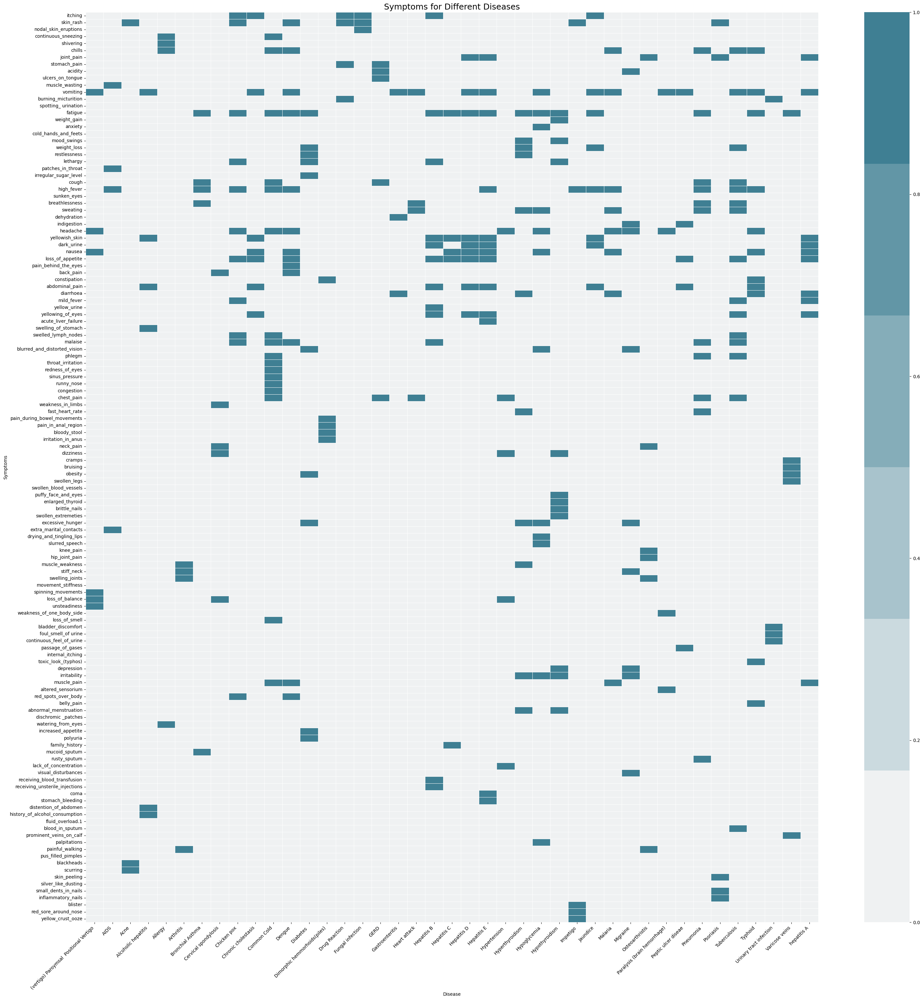

In [33]:
# Creating a matrix to store presence (1) or absence (0) of symptoms for each disease
symptom_matrix = pd.DataFrame(index=train.columns[:-1], columns=grouped_by_disease.groups.keys())

# Filling the matrix with 1 if symptoms are present for the disease, else 0
for disease, group_data in grouped_by_disease:
    symptom_matrix[disease] = (group_data.iloc[0, :-1]==1).astype(int)

plt.figure(figsize=(36, 36))
sns.heatmap(symptom_matrix, cmap=sns.light_palette('#3F7F93'), annot=False, linewidth=0.5)
plt.title('Symptoms for Different Diseases', fontsize=18)
plt.xlabel('Disease')
plt.ylabel('Symptoms')
plt.xticks(rotation=45, ha='right')
plt.show()

In [34]:
# Total occurrence of each symptom for each disease
df = train.groupby('prognosis').sum()
df = df.reset_index()
df.T

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40
prognosis,(vertigo) Paroymsal Positional Vertigo,AIDS,Acne,Alcoholic hepatitis,Allergy,Arthritis,Bronchial Asthma,Cervical spondylosis,Chicken pox,Chronic cholestasis,Common Cold,Dengue,Diabetes,Dimorphic hemmorhoids(piles),Drug Reaction,Fungal infection,GERD,Gastroenteritis,Heart attack,Hepatitis B,Hepatitis C,Hepatitis D,Hepatitis E,Hypertension,Hyperthyroidism,Hypoglycemia,Hypothyroidism,Impetigo,Jaundice,Malaria,Migraine,Osteoarthristis,Paralysis (brain hemorrhage),Peptic ulcer diseae,Pneumonia,Psoriasis,Tuberculosis,Typhoid,Urinary tract infection,Varicose veins,hepatitis A
itching,0,0,0,0,0,0,0,0,114,114,0,0,0,0,114,108,0,0,0,114,0,0,0,0,0,0,0,0,114,0,0,0,0,0,0,0,0,0,0,0,0
skin_rash,0,0,114,0,0,0,0,0,114,0,0,114,0,0,108,108,0,0,0,0,0,0,0,0,0,0,0,114,0,0,0,0,0,0,0,114,0,0,0,0,0
nodal_skin_eruptions,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,108,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
continuous_sneezing,0,0,0,0,108,0,0,0,0,0,114,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
shivering,0,0,0,0,108,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
chills,0,0,0,0,108,0,0,0,0,0,114,114,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,114,0,0,0,0,114,0,114,120,0,0,0
joint_pain,0,0,0,0,0,0,0,0,0,0,0,114,0,0,0,0,0,0,0,0,0,114,114,0,0,0,0,0,0,0,0,114,0,0,0,114,0,0,0,0,114
stomach_pain,0,0,0,0,0,0,0,0,0,0,0,0,0,0,108,0,114,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
acidity,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,108,0,0,0,0,0,0,0,0,0,0,0,0,0,114,0,0,0,0,0,0,0,0,0,0


In [35]:
# A network visualization of the relationship between symptoms and diseases using a directed graph.
import networkx as nx

G = nx.DiGraph()

diseases = train['prognosis'].unique()
G.add_nodes_from(diseases, node_type='disease')

for disease, group_data in grouped_by_disease:
    symptoms_with_1 = group_data.columns[:-1][group_data.iloc[0, :-1] == 1].tolist()
    G.add_nodes_from(symptoms_with_1, node_type='symptom')
    G.add_edges_from([(symptom, disease) for symptom in symptoms_with_1])

disease_nodes = [node for node, node_type in G.nodes(data='node_type') if node_type == 'disease']
symptom_nodes = [node for node, node_type in G.nodes(data='node_type') if node_type == 'symptom']

degree = dict(G.degree())

pos = nx.spring_layout(G)
plt.figure(figsize=(120, 120))
nx.draw_networkx_nodes(G, pos, nodelist=disease_nodes, node_size=[degree[node] * 300 for node in disease_nodes], node_color='#c3583d', label='Diseases')
nx.draw_networkx_nodes(G, pos, nodelist=symptom_nodes, node_size=[degree[node] * 300 for node in symptom_nodes], node_color='#3F7F93', label='Symptoms')
nx.draw_networkx_edges(G, pos, width=0.5, edge_color='gray')
nx.draw_networkx_labels(G, pos, font_size=6, font_color='black')
plt.title('Symptoms-Disease Network', fontsize=36)
plt.legend()
plt.show()

The graph visualizes the Symptoms-Disease Network, where diseases and symptoms are represented as nodes, and the edges indicate the relationship between symptoms and the diseases they are associated with.

# Data Preprocessing

In [36]:
train.shape

(4920, 132)

Since the dataset consists of binary values (0s and 1s) for symptoms and the target variable, additional modifications or complex adjustments are not required. The data is straightforward and balanced. So, we can proceed with building models without the need for further changes to the features.

However, in the exploration of the original dataset encompassing 132 symptoms, a notable challenge surfaced as all models exhibited 100% accuracy on both the training and testing datasets with cross–validation. While achieving perfect accuracy may initially seem like a positive outcome, this anomaly suggested potential overfitting or a fixed pattern within the dataset, raising concerns about model generalization.

## Feature Selection

In [37]:
from sklearn.feature_selection import SelectKBest, chi2

In [38]:
train_features = train.drop('prognosis', axis=1)
test_features = test.drop(['prognosis'], axis=1)
labels = train['prognosis']

In [39]:
# Identifying and dropping the top 20 least informative features based on the chi-squared test scores
k_best_selector = SelectKBest(chi2, k='all')
train_scores = k_best_selector.fit_transform(train_features, labels)
feature_scores = k_best_selector.scores_
sorted_indices = np.argsort(feature_scores)
features_to_drop_indices = sorted_indices[:20]
features_to_drop = train_features.columns[features_to_drop_indices]
print('Features to Drop:', features_to_drop)

Features to Drop: Index(['vomiting', 'fatigue', 'high_fever', 'headache', 'nausea',
       'loss_of_appetite', 'abdominal_pain', 'yellowish_skin', 'skin_rash',
       'chills', 'itching', 'sweating', 'yellowing_of_eyes', 'joint_pain',
       'cough', 'diarrhoea', 'chest_pain', 'foul_smell_of urine', 'malaise',
       'dark_urine'],
      dtype='object')


In [40]:
train_features = train_features.drop(columns=features_to_drop)
test_features = test_features.drop(columns=features_to_drop)

In [41]:
train_features.shape

(4920, 111)

# Machine Learning Models

In [42]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import cross_val_score

In [43]:
# Splitting data into 70% train and 30% test
X_train, X_test, y_train, y_test = train_test_split(train_features, labels, test_size = 0.3, random_state = 0)

print(f'X-Train: {X_train.shape},Y-Train: {y_train.shape}')
print(f'X-Test: {X_test.shape}, Y-Train:{y_test.shape}')

X-Train: (3444, 111),Y-Train: (3444,)
X-Test: (1476, 111), Y-Train:(1476,)


**Logistic Regression**

In [44]:
lg = LogisticRegression(multi_class='ovr')
lg.fit(X_train, y_train)

lg_scores = cross_val_score(lg, X_train, y_train, cv=5)
print('Logistic Regression')
print(f'Cross-validation Scores:', ', '.join(map(str, lg_scores)))
print(f'Mean Cross-validation Score: {lg_scores.mean():.2f}')

Logistic Regression
Cross-validation Scores: 0.9724238026124818, 0.9724238026124818, 0.9709724238026125, 0.9709724238026125, 0.9723837209302325
Mean Cross-validation Score: 0.97


We used the "One versus Rest" strategy, where the model is trained to distinguish each class from the rest individually in multi-class classification problems.

**Random Forest**

In [45]:
rf = RandomForestClassifier(max_depth=10, random_state=0)
rf.fit(X_train, y_train)

rf_scores = cross_val_score(rf, X_train, y_train, cv=5)
print('Random Forest')
print(f'Cross-validation Scores:', ', '.join(map(str, rf_scores)))
print(f'Mean Cross-validation Score: {rf_scores.mean():.2f}')

Random Forest
Cross-validation Scores: 0.9709724238026125, 0.9201741654571843, 0.9709724238026125, 0.9477503628447025, 0.9694767441860465
Mean Cross-validation Score: 0.96


We used the "max_depth" parameter to control the depth of the tree to influence the model's complexity and potential overfitting.

**Decision Tree**

In [46]:
dt = DecisionTreeClassifier(random_state=0)
dt.fit(X_train, y_train)

dt_scores = cross_val_score(dt, X_train, y_train, cv=5)
print('Decision Tree')
print(f'Cross-validation Scores:', ', '.join(map(str, dt_scores)))
print(f'Mean Cross-validation Score: {dt_scores.mean():.2f}')

Decision Tree
Cross-validation Scores: 0.9680696661828737, 0.9724238026124818, 0.9709724238026125, 0.9709724238026125, 0.9709302325581395
Mean Cross-validation Score: 0.97


**Naive Bayes**

In [47]:
nb = GaussianNB()
nb.fit(X_train, y_train)

nb_scores = cross_val_score(nb, X_train, y_train, cv=5)
print('Gaussian Naive Bayes')
print(f'Cross-validation Scores:', ', '.join(map(str, nb_scores)))
print(f'Mean Cross-validation Score: {nb_scores.mean():.2f}')

Gaussian Naive Bayes
Cross-validation Scores: 0.9724238026124818, 0.9724238026124818, 0.9709724238026125, 0.9709724238026125, 0.9723837209302325
Mean Cross-validation Score: 0.97


**Support Vector Machine**

In [48]:
svc = SVC(C=0.1, random_state=0)
svc.fit(X_train, y_train)

svc_scores = cross_val_score(svc, X_train, y_train, cv=5)
print('Support Vector Classifier')
print(f'Cross-validation Scores:', ', '.join(map(str, svc_scores)))
print(f'Mean Cross-validation Score: {svc_scores.mean():.2f}')

Support Vector Classifier
Cross-validation Scores: 0.965166908563135, 0.965166908563135, 0.965166908563135, 0.965166908563135, 0.9723837209302325
Mean Cross-validation Score: 0.97


We used the "C" parameter which represents the regularization strength, controlling the trade-off between achieving a smooth decision boundary and classifying training points correctly. The C=0.1 configuration sets a relatively low penalty for misclassification in the SVM, allowing for a more flexible model that may generalize better to unseen data but could be more tolerant of misclassified points in the training set.

**K-Nearest Neighbors**

In [49]:
knn = KNeighborsClassifier(weights='distance', n_neighbors=3)
knn.fit(X_train, y_train)

knn_scores = cross_val_score(knn, X_train, y_train, cv=5)
print('K-Nearest Neighbors')
print(f'Cross-validation Scores:', ', '.join(map(str, knn_scores)))
print(f'Mean Cross-validation Score: {knn_scores.mean():.2f}')

K-Nearest Neighbors
Cross-validation Scores: 0.9724238026124818, 0.9709724238026125, 0.9709724238026125, 0.969521044992743, 0.9709302325581395
Mean Cross-validation Score: 0.97


The 'weights' parameter determines whether neighboring points are weighted by their inverse distance ('distance') when making predictions for a new data point. 'n_neighbors' determines number of neighbors to use.

**Voting Classifier using Decision Tree and KNN**

In [50]:
from sklearn.ensemble import VotingClassifier
models = [('Decision Tree', dt),
          ('KNN', knn)]

vc = VotingClassifier(estimators=models, voting='hard')
vc.fit(X_train, y_train)
vc_scores = cross_val_score(vc, X_train, y_train, cv=5)

print('Voting Classifier')
print(f'Cross-validation Scores:', ', '.join(map(str, vc_scores)))
print(f'Mean Cross-validation Score: {vc_scores.mean():.2f}')

Voting Classifier
Cross-validation Scores: 0.9680696661828737, 0.9724238026124818, 0.9709724238026125, 0.9709724238026125, 0.9723837209302325
Mean Cross-validation Score: 0.97


The models demonstrated high accuracy, with Logistic Regression, Decision Tree, Naive Bayes, K-Nearest Neighbors and the Voting Classifier consistently achieving impressive cross-validation scores around 97%. Random Forest, known for its robustness, also exhibited a strong mean cross-validation score of 96%. These results indicate the models' ability to accurately classify diseases based on the given symptoms.

## Performance Evaluation

In [51]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
from sklearn.preprocessing import label_binarize

In [52]:
models = {
    'Logistic Regression': lg,
    'Random Forest': rf,
    'Decision Tree': dt,
    'Naive Bayes': nb,
    'SVM': svc,
    'KNN': knn,
    'Voting Classifier': vc
}

In [53]:
model_names = []
accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
roc_auc_scores = []

In [54]:
for model_name, model in models.items():
    y_pred = model.predict(X_test)
    y_binary = label_binarize(y_test, classes=model.classes_)
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='weighted')
    recall = recall_score(y_test, y_pred, average='weighted')
    f1 = f1_score(y_test, y_pred, average='weighted')

    model_names.append(model_name)
    accuracy_scores.append(accuracy)
    precision_scores.append(precision)
    recall_scores.append(recall)
    f1_scores.append(f1)

scores_df = pd.DataFrame({
    'Model': model_names,
    'Accuracy': accuracy_scores,
    'Precision': precision_scores,
    'Recall': recall_scores,
    'F1 Score': f1_scores
})

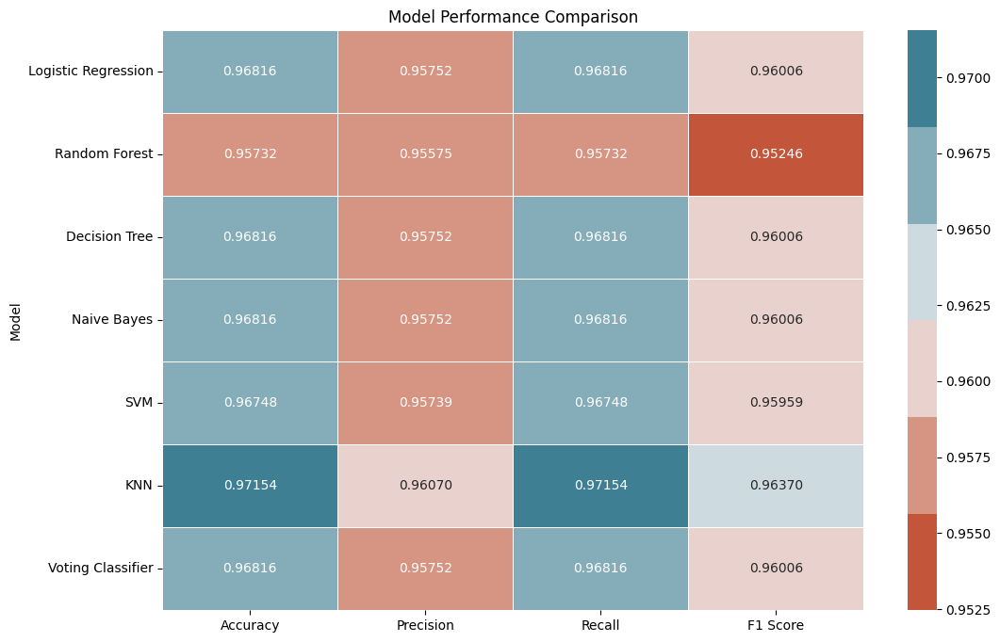

In [55]:
plt.figure(figsize=(12, 8))
sns.heatmap(scores_df.set_index('Model'), annot=True, cmap=sns.diverging_palette(20, 220), fmt='.5f', linewidths=.5)
plt.title('Model Performance Comparison')
plt.show()

The models generally exhibit high accuracy and balanced performance across precision, recall and F1 score. The KNN model stands out with the highest accuracy, precision, recall and F1 score among the models evaluated.

In [56]:
# Application of Trained Model on the Test Dataset
test['predicted_lg'] = lg.predict(test_features)
test['predicted_rf'] = rf.predict(test_features)
test['predicted_dt'] = dt.predict(test_features)
test['predicted_nb'] = nb.predict(test_features)
test['predicted_svc'] = svc.predict(test_features)
test['predicted_knn'] = knn.predict(test_features)
test['predicted_vc'] = vc.predict(test_features)

result_df = test[['prognosis', 'predicted_lg', 'predicted_rf', 'predicted_dt', 'predicted_nb', 'predicted_svc', 'predicted_knn', 'predicted_vc']]
result_df

,prognosis,predicted_lg,predicted_rf,predicted_dt,predicted_nb,predicted_svc,predicted_knn,predicted_vc
0,Fungal infection,Fungal infection,Fungal infection,Fungal infection,Fungal infection,Fungal infection,Fungal infection,Fungal infection
1,Allergy,Allergy,Allergy,Allergy,Allergy,Allergy,Allergy,Allergy
2,GERD,GERD,GERD,GERD,GERD,GERD,GERD,GERD
3,Chronic cholestasis,Chronic cholestasis,Chronic cholestasis,Chronic cholestasis,Chronic cholestasis,Chronic cholestasis,Hepatitis D,Chronic cholestasis
4,Drug Reaction,Drug Reaction,Drug Reaction,Drug Reaction,Drug Reaction,Drug Reaction,Drug Reaction,Drug Reaction
5,Peptic ulcer diseae,Peptic ulcer diseae,Peptic ulcer diseae,Peptic ulcer diseae,Peptic ulcer diseae,Peptic ulcer diseae,Peptic ulcer diseae,Peptic ulcer diseae
6,AIDS,AIDS,AIDS,AIDS,AIDS,AIDS,AIDS,AIDS
7,Diabetes,Diabetes,Diabetes,Diabetes,Diabetes,Diabetes,Diabetes,Diabetes
8,Gastroenteritis,Gastroenteritis,Gastroenteritis,Gastroenteritis,Gastroenteritis,Gastroenteritis,Gastroenteritis,Gastroenteritis
9,Bronchial Asthma,Bronchial Asthma,Bronchial Asthma,Bronchial Asthma,Bronchial Asthma,Bronchial Asthma,Bronchial Asthma,Bronchial Asthma


All algorithms demonstrated consistent performance by correctly predicting 40 instances and making only 2 incorrect prediction each.

## Model Explainability

### Decision Tree Visualization

In [57]:
from sklearn.tree import export_text
from sklearn.tree import plot_tree

In [58]:
rf.estimators_[0]

DecisionTreeClassifier(max_depth=10, max_features='sqrt',
                       random_state=209652396)

In [59]:
# Plotting the decision tree of the first estimator in the Random Forest
plt.figure(figsize=(120, 120))
plot_tree(rf.estimators_[0], feature_names=train_features.columns, class_names=labels.unique(), filled=True, rounded=True)
plt.show()

The tree uses a set of rules to make predictions based on input symptom values. The leaf nodes represent the predicted class for the given set of conditions. For example, the feature used for the first split is "dehydration". The tree starts by checking if the value of the feature "dehydration" is less than or equal to 0.50. If true, it proceeds to check the value of the "cramps" feature and gives the prediction of "Alcoholic hepatitis". The process continues with nested conditions for features until it reaches a leaf node with a specific disease class.

In [60]:
# Plotting the decision tree for the Decision Tree Classifier
plt.figure(figsize=(120, 100))
plot_tree(dt, filled=True, feature_names=train_features.columns, class_names=[str(c) for c in dt.classes_], rounded=True, fontsize=8)
plt.show()

This decision tree's first decision is whether the patient has "increased_appetite" or not. If not, it further checks if "irritation_in_anus" is present, leading to a prediction of "Dimorphic hemmorhoids(piles)." If "irritation_in_anus" is not present, the prediction is "Chicken Pox". If "increased_appetite" is present, it examines various symptoms like "runny_nose," "brittle_nails," "rusty_sputum" etc. to ultimately predict diseases like "Pneumonia," "Hypothyroidism," "Impetigo" etc.

### Feature Importance

In [61]:
# Features ranked by their importance according to the decision tree model
importance_df = pd.DataFrame({'Feature': X_test.columns, 'Importance': dt.feature_importances_*100})
importance_df.sort_values(by='Importance', ascending=False)

,Feature,Importance
19,breathlessness,3.999423
83,increased_appetite,2.881823
22,pain_behind_the_eyes,2.822779
42,irritation_in_anus,2.814834
35,runny_nose,2.731781
52,brittle_nails,2.671870
87,rusty_sputum,2.671694
110,yellow_crust_ooze,2.664142
78,red_spots_over_body,2.661292
99,palpitations,2.640683


The "Importance" column represents the relative importance of each feature in predicting the target variable (prognosis). The higher the importance value, the more influential the feature is in making predictions.

The model places significant emphasis on symptoms associated with respiratory and cardiovascular issues.

### SHAP

We chose Random Forest to analyze explainability in this part.

In [62]:
!pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 533.5/533.5 kB 6.5 MB/s eta 0:00:00


In [63]:
import shap

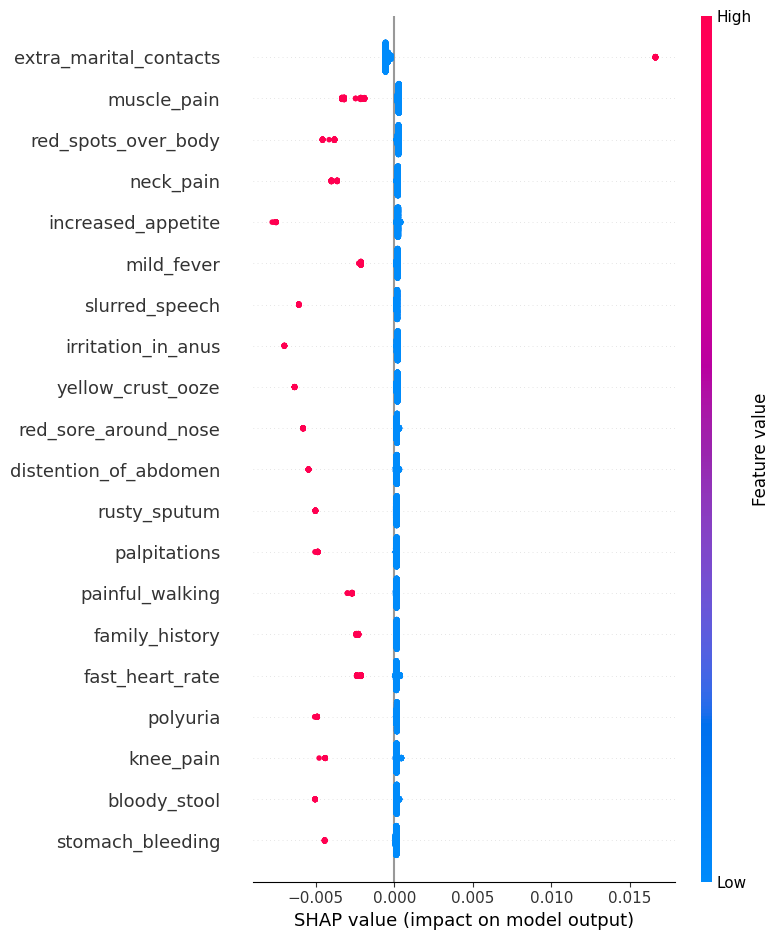

In [64]:
# Model Interpretation with SHAP
explainer = shap.TreeExplainer(rf)

shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values[1], X_test)

The SHAP values for the Decision Tree model represent the impact of each feature on the model's output for a specific instance. Positive values contribute to increasing the model's output, while negative values contribute to decreasing it. For example, "muscle_pain" has a small positive impact while "extra_marital_contacts" has a small negative impact.

In [65]:
# SHAP values for the selected instance for better understanding
print(f'SHAP values for instance {0}:\n')
for feature, shap_value in zip(X_test.columns, shap_values[1][0]):
    print(f'{feature}: {shap_value:.4f}')

SHAP values for instance 0:

nodal_skin_eruptions: 0.0000
continuous_sneezing: 0.0001
shivering: 0.0001
stomach_pain: 0.0001
acidity: 0.0000
ulcers_on_tongue: 0.0000
muscle_wasting: 0.0000
burning_micturition: 0.0000
spotting_ urination: 0.0000
weight_gain: 0.0000
anxiety: 0.0001
cold_hands_and_feets: 0.0000
mood_swings: 0.0000
weight_loss: 0.0000
restlessness: 0.0000
lethargy: 0.0001
patches_in_throat: 0.0000
irregular_sugar_level: 0.0001
sunken_eyes: 0.0000
breathlessness: 0.0001
dehydration: 0.0000
indigestion: 0.0000
pain_behind_the_eyes: 0.0001
back_pain: 0.0001
constipation: -0.0003
mild_fever: 0.0002
yellow_urine: 0.0001
acute_liver_failure: 0.0000
swelling_of_stomach: 0.0001
swelled_lymph_nodes: 0.0001
blurred_and_distorted_vision: 0.0000
phlegm: 0.0000
throat_irritation: 0.0001
redness_of_eyes: 0.0001
sinus_pressure: 0.0001
runny_nose: 0.0001
congestion: 0.0001
weakness_in_limbs: 0.0000
fast_heart_rate: 0.0001
pain_during_bowel_movements: 0.0001
pain_in_anal_region: 0.0001
blo